In [1]:
%matplotlib inline
from astropy.io import fits
import numpy as np
import copy
import matplotlib.pyplot as plt
import constants as pc

In [2]:
# import a code file hydro3.py
import hydro3

# define a dictionary with some arguments that we will pass to the hydrodynamics code
# the "hnames" and "htype" arguments mean we are using a solution for a massive star from Heger & Woosley
# it has "zero" metallicity, meaning it will be a blue supergiant star

# noplot means we aren't going to draw plots as the code runs, which makes it faster
args = {'hname':'z11.0','htype':'zero','noplot':1,'t_stop':2.5e2}

# define the variable h which is a "lagrange_hydro_1d" object (instance of a class)
h = hydro3.lagrange_hydro_1d(**args)

# this tells the hydro code that we are using a Heger & Woosley star (e.g., so that it knows how to read the file)
h.itype=h.HEGER

In [3]:
# variables stored within our object h are accessed by h.variable_name
# use your past labs and class notebooks, the hydro code notes, and class slides for help!
h.bctype=[h.INFLOW, h.OUTFLOW]
h.setup_initial_conditions()
h.initialize_boundary_conditions()

header:  ['grid', 'cell', 'outer', 'total', 'mass', 'cell', 'outer', 'radius', 'cell', 'outer', 'velocity', 'cell', 'density', 'cell', 'temperature', 'cell', 'pressure', 'cell', 'specific', 'energy', 'cell', 'specific', 'entropy', 'cell', 'angular', 'velocity', 'cell', 'A_bar', 'cell', 'Y_e', 'stability', 'NETWORK', 'neutrons', 'H1', 'He3', 'He4', 'C12', 'N14', 'O16', 'Ne20', 'Mg24', 'Si28', 'S32', 'Ar36', 'Ca40', 'Ti44', 'Cr48', 'Fe52', 'Fe54', 'Ni56', 'Fe56', "'Fe'"]
r inner:  270890497.82996696


gzip: heger_progenitors/zero/z11.0 already exists;	not overwritten
gzip: heger_progenitors/zero/z11.0.gz already exists;	not overwritten


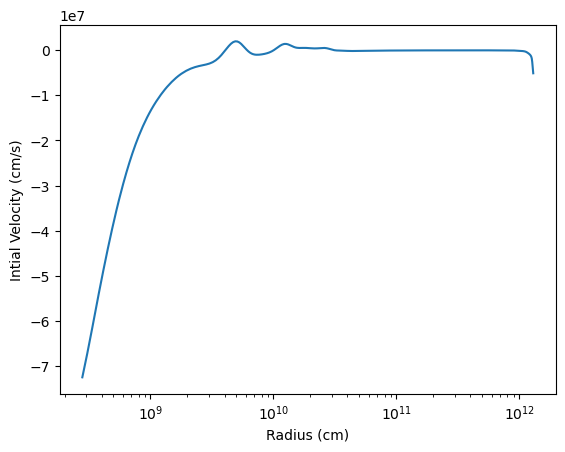

In [5]:
plt.semilogx(h.zones.r, h.zones.v)
plt.xlabel('Radius (cm)')
plt.ylabel('Intial Velocity (cm/s)');

In [5]:
U = 1e52          # create a variable for the initial energy
V = ((4/3) * np.pi * (h.zones.r[5])**3)      # calculate total volume 
u = U/V        # calculate internal energy density

rho = h.zones.d[5]       # calculate density of the first five zones
e = u / rho        # calculate energy per unit mass

h.zones.e[:5] = e   # distribute the initial energy per unit mass to the first 5 zones

In [6]:
h.run()

     0 0.000e+00 1.940e-03
2.974e+33 1.100e+01 3.113e+47 4.728e+51 -2.502e+50 4.478e+51
   100 1.325e-02 8.281e-05
2.974e+33 1.100e+01 1.322e+51 4.398e+51 -2.443e+50 5.475e+51
   200 1.992e-02 4.911e-05
2.974e+33 1.100e+01 2.398e+51 4.818e+51 -2.374e+50 6.979e+51
   300 2.424e-02 4.111e-05
2.974e+33 1.100e+01 2.947e+51 5.102e+51 -2.328e+50 7.816e+51


/home/phdo8065/astr3400/Final Project/hydro3.py:502: RuntimeWarning: divide by zero encountered in divide
  new_d = self.zones.mass/self.zones.vol
/home/phdo8065/astr3400/Final Project/hydro3.py:527: RuntimeWarning: invalid value encountered in multiply
  self.zones.p = (self.gamma - 1)*new_e*new_d


   400 2.860e-02 4.747e-05
2.974e+33 1.100e+01 3.529e+51 5.192e+51 -2.283e+50 8.492e+51
   500 3.407e-02 6.123e-05
2.974e+33 1.100e+01 4.260e+51 5.260e+51 -2.227e+50 9.297e+51
   600 3.925e-02 4.898e-05
2.974e+33 1.100e+01 4.835e+51 5.477e+51 -2.175e+50 1.009e+52
   700 4.483e-02 5.786e-05
2.974e+33 1.100e+01 5.504e+51 5.731e+51 -2.122e+50 1.102e+52
   800 5.007e-02 4.542e-05
2.974e+33 1.100e+01 6.071e+51 6.004e+51 -2.074e+50 1.187e+52
   900 5.479e-02 4.813e-05
2.974e+33 1.100e+01 6.565e+51 6.153e+51 -2.033e+50 1.251e+52
  1000 5.951e-02 4.816e-05
2.974e+33 1.100e+01 7.033e+51 6.276e+51 -1.995e+50 1.311e+52
  1100 6.411e-02 4.364e-05
2.974e+33 1.100e+01 7.385e+51 6.480e+51 -1.958e+50 1.367e+52
  1200 6.805e-02 3.922e-05
2.974e+33 1.100e+01 7.696e+51 6.635e+51 -1.928e+50 1.414e+52
  1300 7.221e-02 4.522e-05
2.974e+33 1.100e+01 8.092e+51 6.738e+51 -1.898e+50 1.464e+52
  1400 7.741e-02 5.944e-05
2.974e+33 1.100e+01 8.610e+51 6.854e+51 -1.861e+50 1.528e+52
  1500 8.359e-02 6.392e-05
2.974

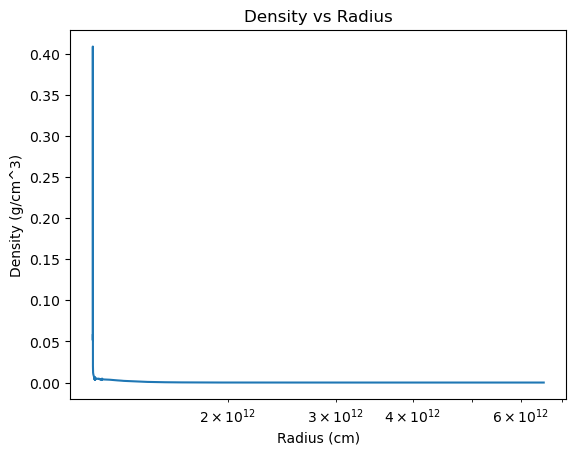

In [7]:
plt.semilogx(h.zones.r, h.zones.d)
plt.title('Density vs Radius')
plt.xlabel('Radius (cm)')
plt.ylabel('Density (g/cm^3)');

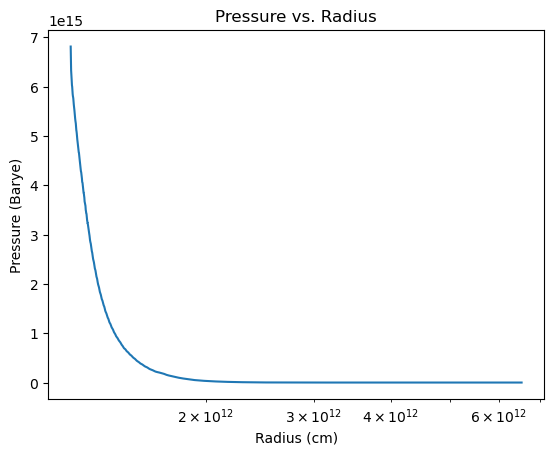

In [8]:
plt.semilogx(h.zones.r, h.zones.p)
plt.title('Pressure vs. Radius')
plt.xlabel('Radius (cm)')
plt.ylabel('Pressure (Barye)');

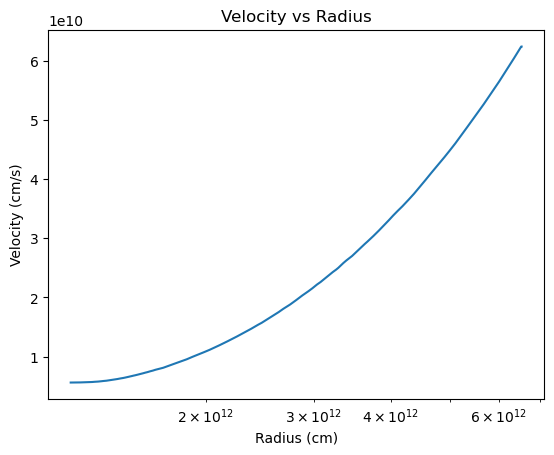

In [9]:
plt.semilogx(h.zones.r, h.zones.v)
plt.title('Velocity vs Radius')
plt.xlabel('Radius (cm)')
plt.ylabel('Velocity (cm/s)');

In [10]:
h.t_stop=h.t*2.
h.run()

1332600 2.500e+02 1.639e-04
2.974e+33 1.100e+01 3.709e+53 5.371e+52 -1.113e+49 4.246e+53
1332700 2.500e+02 1.639e-04
2.974e+33 1.100e+01 3.709e+53 5.370e+52 -1.113e+49 4.246e+53
1332800 2.500e+02 1.639e-04
2.974e+33 1.100e+01 3.709e+53 5.370e+52 -1.113e+49 4.246e+53
1332900 2.500e+02 1.639e-04
2.974e+33 1.100e+01 3.709e+53 5.370e+52 -1.113e+49 4.246e+53
1333000 2.501e+02 1.639e-04
2.974e+33 1.100e+01 3.709e+53 5.369e+52 -1.113e+49 4.246e+53
1333100 2.501e+02 1.639e-04
2.974e+33 1.100e+01 3.710e+53 5.369e+52 -1.113e+49 4.246e+53
1333200 2.501e+02 1.638e-04
2.974e+33 1.100e+01 3.710e+53 5.368e+52 -1.113e+49 4.246e+53
1333300 2.501e+02 1.638e-04
2.974e+33 1.100e+01 3.710e+53 5.368e+52 -1.112e+49 4.247e+53
1333400 2.501e+02 1.638e-04
2.974e+33 1.100e+01 3.710e+53 5.368e+52 -1.112e+49 4.247e+53
1333500 2.501e+02 1.638e-04
2.974e+33 1.100e+01 3.710e+53 5.367e+52 -1.112e+49 4.247e+53
1333600 2.502e+02 1.638e-04
2.974e+33 1.100e+01 3.710e+53 5.367e+52 -1.112e+49 4.247e+53
1333700 2.502e+02 1.6

/home/phdo8065/astr3400/Final Project/hydro3.py:440: RuntimeWarning: invalid value encountered in sqrt
  self.zones.cs = (self.gamma*self.zones.p/self.zones.d)**0.5


neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
2178700 3.774e+02 1.407e-04
2.974e+33 1.100e+01 4.695e+53 3.596e+52 -6.935e+48 5.054e+53
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!
neg energy!

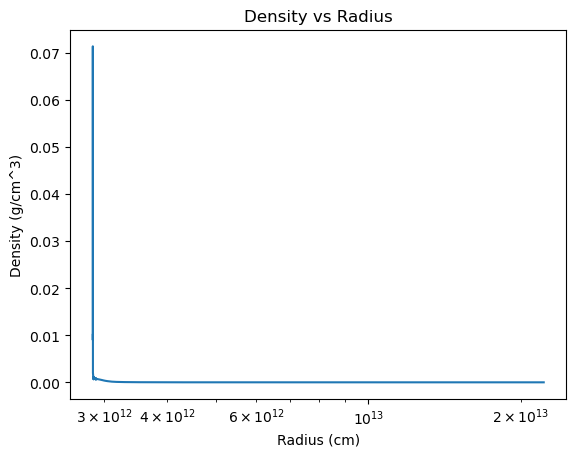

In [11]:
plt.semilogx(h.zones.r, h.zones.d)
plt.title('Density vs Radius')
plt.xlabel('Radius (cm)')
plt.ylabel('Density (g/cm^3)');

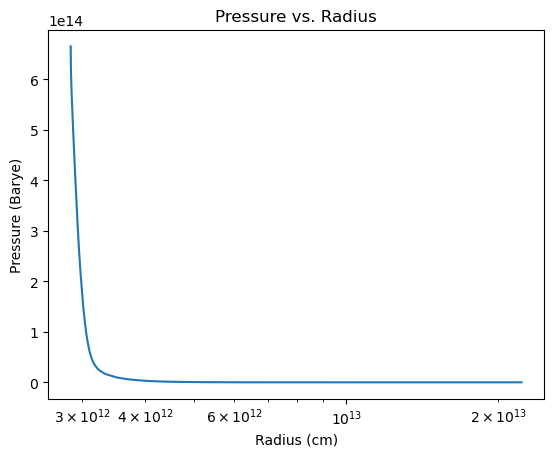

In [12]:
plt.semilogx(h.zones.r, h.zones.p)
plt.title('Pressure vs. Radius')
plt.xlabel('Radius (cm)')
plt.ylabel('Pressure (Barye)');

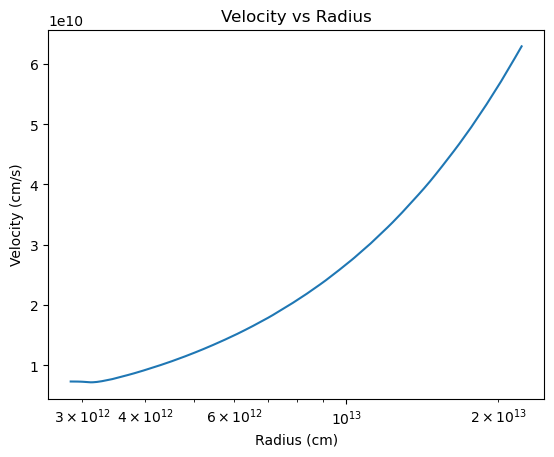

In [13]:
plt.semilogx(h.zones.r, h.zones.v)
plt.title('Velocity vs Radius')
plt.xlabel('Radius (cm)')
plt.ylabel('Velocity (cm/s)');